## Laboratorium 7

## Detekcja obiektów za pomocą Faster-RCNN

### Wprowadzenie

Celem tej listy jest praktyczne zapoznanie się z działaniem dwuetapowych modeli do detekcji obiektów na przykładzie Faster R-CNN. Skorzystamy z gotowej implementacji modelu z pakietu [`torchvision`](https://github.com/pytorch/vision/blob/main/torchvision/models/detection/faster_rcnn.py). Jeżeli masz inny ulubiony model działający na podobnej zasadzie, możesz z niego skorzystać zamiast podanego. Podobnie implementacja - jeśli masz swoją ulubioną bibliotekę np. Detectron2, MMDetection, możesz z niej skorzystać.

W zadaniu wykorzystany zostanie zbiór danych [_Chess Pieces Dataset_](https://public.roboflow.com/object-detection/chess-full) (autorstwa Roboflow, domena publiczna), ZIP z obrazami i anotacjami powinien być dołączony do instrukcji.

Podczas realizacji tej listy większy nacisk położony zostanie na inferencję z użyciem Faster R-CNN niż na uczenie (które przeprowadzisz raz\*). Kluczowe komponenty w tej architekturze (RPN i RoIHeads) można konfigurować bez ponownego uczenia, dlatego badania skupią się na ich strojeniu. Aby zrozumieć działanie modelu, konieczne będzie spojrzenie w jego głąb, włącznie z częściowym wykonaniem. W tym celu warto mieć na podorędziu kod źródłowy, w szczególności implementacje następujących klas (uwaga - linki do najnowszej implementacji; upewnij się więc, że czytasz kod używanej przez siebie wersji biblioteki):

- `FasterRCNN`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/faster_rcnn.py
- `GeneralizedRCNN`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/generalized_rcnn.py
- `RegionProposalNetwork`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/rpn.py
- `RoIHeads`: https://github.com/pytorch/vision/blob/main/torchvision/models/detection/roi_heads.py

Dogłębne zrozumienie procedury uczenia modelu nie będzie wymagane, niemniej należy mieć ogólną świadomość jak ten proces przebiega i jakie funkcje kosztu są wykorzystywane. Użyjemy gotowej implementacji z submodułu [`references.detection`](https://github.com/pytorch/vision/blob/main/references/detection/train.py) w nieco uproszczonej wersji. Ponieważ ten moduł **nie** jest domyślnie instalowaną częścią pakietu `torchvision`, do instrukcji dołączono jego kod w nieznacznie zmodyfikowanej wersji (`references_detection.zip`).
Jeśli ciekawią Cię szczegóły procesu uczenia, zachęcam do lektury [artykułu](https://arxiv.org/abs/1506.01497) i analizy kodu implementacji.


### Library install


In [1]:
!pip install pycocotools


[notice] A new release of pip is available: 24.0 -> 24.3.1
[notice] To update, run: pip install --upgrade pip


### Imports and constants


In [1]:
import os
import time
import datetime

import torch
import torch.utils.data
import torchvision
import torchvision.models.detection as M
from torchvision.models.detection import FasterRCNN
from torchvision.io.image import read_image
from torchvision.utils import draw_bounding_boxes
from torchvision.transforms.functional import to_pil_image

from detection import coco_utils, presets, utils, transforms
from detection.engine import train_one_epoch, evaluate

import matplotlib.pyplot as plt
import pandas as pd

In [2]:
USE_PRETRAINED = True

In [3]:
# Konfiguracja hiperparametrów
LR = 0.001  # powinno być dobrze dla 1 GPU
WDECAY = 0.0001
EPOCHS = 25
VAL_FREQ = 5  # walidacja i checkpointowanie co N epok
BATCH_SIZE = 2  # dobierz pod możliwości sprzętowe
NUM_WORKERS = 8  # j/w
NUM_CLASSES = 14
DEVICE = "cuda:0"
DATASET_ROOT = "chess/"
OUTPUT_DIR = "outputs/"

In [4]:
file_names = [
    "valid/3baf85c957b9d28a16c0b65cb2ef0d29_jpg.rf.ee68e051c8a61b8784b87686d828cf59.jpg",
    "valid/495019998442ddf85b59e387d4916cd3_jpg.rf.9d9d8ec43f8494e2bfe6603811f7b3de.jpg",
    "valid/55be99616328f83dcbfe8c18e1387c0e_jpg.rf.704f9d21a024a31afa058f00ea6d6ca9.jpg",
    "valid/bb0de9761d16eee258ae09d8de32002c_jpg.rf.c11059695bd371034e76c84073775603.jpg",
    "valid/7e97f49e613a59a70b833e4c0b2c1c04_jpg.rf.e3d8cc08e136002cec4bf8350be37c47.jpg",
    "wild/chesscom_fide.jpeg",
    "wild/chesscom_uscf.jpeg",
    "wild/shop.jpg",
]

### Zadanie 0: Uczenie

Krokiem "zerowym" będzie przygotowanie wstępnie nauczonego modelu i douczenie go na docelowym zbiorze.
Podany zestaw hiperparametrów powinien dawać przyzwoite (niekoniecznie idealne) wyniki - jeśli chcesz, śmiało dobierz swoje własne; nie spędzaj na tym jednak zbyt wiele czasu.

Twoim zadaniem jest nie tylko przeklikanie poniższych komórek, ale przynajmniej ogólne zrozumienie procesu uczenia (przejrzyj implementację `train_one_epoch`) i struktury modelu.


In [5]:
def get_dataset(img_root: str, file_name: str, train: bool = True):
    """Reimplementacja analogicznej funkcji z pakietu references, rozwiązująca drobną niekompatybilność w zbiorze CPD"""

    def fake_segmentation(image, target):
        for obj in target["annotations"]:
            x, y, w, h = obj["bbox"]
            segm = [x, y, x + w, y, x + w, y + h, x, y + h]
            obj["segmentation"] = [segm]
        return image, target

    tfs = transforms.Compose(
        [
            fake_segmentation,
            coco_utils.ConvertCocoPolysToMask(),
            (
                presets.DetectionPresetTrain(data_augmentation="hflip")
                if train
                else presets.DetectionPresetEval()
            ),
            # jeśli chcesz dodać swoje własne augmentacje, możesz zrobić to tutaj
        ]
    )
    ds = coco_utils.CocoDetection(img_root, file_name, transforms=tfs)
    return ds

In [6]:
# Zaczytanie datasetów
chess_train = get_dataset(
    os.path.join(DATASET_ROOT, "train"),
    os.path.join(DATASET_ROOT, "train/_annotations.coco.json"),
)
chess_val = get_dataset(
    os.path.join(DATASET_ROOT, "valid"),
    os.path.join(DATASET_ROOT, "valid/_annotations.coco.json"),
    train=False,
)

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


In [7]:
# samplery i loadery
train_sampler = torch.utils.data.RandomSampler(chess_train)
train_batch_sampler = torch.utils.data.BatchSampler(
    train_sampler, BATCH_SIZE, drop_last=True
)
train_loader = torch.utils.data.DataLoader(
    chess_train,
    batch_sampler=train_batch_sampler,
    num_workers=NUM_WORKERS,
    collate_fn=utils.collate_fn,
)

val_sampler = torch.utils.data.SequentialSampler(chess_val)
val_loader = torch.utils.data.DataLoader(
    chess_val,
    batch_size=1,
    sampler=val_sampler,
    num_workers=NUM_WORKERS,
    collate_fn=utils.collate_fn,
)

In [8]:
# Skonstruowanie modelu; tworzymy w wersji dla 91 klas aby zainicjować wagi wstępnie nauczone na COCO...
model = M.fasterrcnn_resnet50_fpn(
    weights=M.FasterRCNN_ResNet50_FPN_Weights.COCO_V1, num_classes=91
).to(DEVICE)
# ...po czym zastępujemy predyktor mniejszym, dostosowanym do naszego zbioru:
model.roi_heads.box_predictor = M.faster_rcnn.FastRCNNPredictor(
    in_channels=1024, num_classes=NUM_CLASSES
).to(DEVICE)

In [9]:
model  # zwróć uwagę na strukturę Box Predictora (dlaczego tyle out_features?)

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [10]:
# load model from checkpoint


def load_model(checkpoint_file: str) -> FasterRCNN:
    """
    Load model from checkpoint
    """
    model = M.fasterrcnn_resnet50_fpn(
        weights=M.FasterRCNN_ResNet50_FPN_Weights.COCO_V1, num_classes=91
    ).to(DEVICE)

    model.roi_heads.box_predictor = M.faster_rcnn.FastRCNNPredictor(
        in_channels=1024, num_classes=NUM_CLASSES
    ).to(DEVICE)

    checkpoint = torch.load(checkpoint_file, weights_only=True)

    model.load_state_dict(checkpoint["model"])
    return model

In [11]:
# Zanim przejdziemy do uczenia pełnego modelu, wykonamy krótkie wstępne uczenie losowo zainicjowanego predyktora:
if not USE_PRETRAINED:
    train_one_epoch(
        model=model,
        optimizer=torch.optim.AdamW(
            model.roi_heads.box_predictor.parameters(), lr=LR, weight_decay=WDECAY
        ),
        data_loader=train_loader,
        device=DEVICE,
        epoch=0,
        print_freq=20,
        scaler=None,
    )

In [12]:
# Uczenie pełnego modelu

if USE_PRETRAINED:
    model = load_model(f"{OUTPUT_DIR}/checkpoint.pth")

else:
    optimizer = torch.optim.AdamW(
        [p for p in model.parameters() if p.requires_grad], lr=LR, weight_decay=WDECAY
    )
    lr_scheduler = torch.optim.lr_scheduler.MultiStepLR(
        optimizer, milestones=[10], gamma=0.1
    )  # dobierz wartości jeśli trzeba

    start_time = time.time()
    for epoch in range(EPOCHS):
        train_one_epoch(model, optimizer, train_loader, DEVICE, epoch, 20, None)
        lr_scheduler.step()

        # eval and checkpoint every VAL_FREQ epochs
        if (epoch + 1) % VAL_FREQ == 0:
            checkpoint = {
                "model": model.state_dict(),
                "optimizer": optimizer.state_dict(),
                "lr_scheduler": lr_scheduler.state_dict(),
                "epoch": epoch,
            }
            utils.save_on_master(
                checkpoint, os.path.join(OUTPUT_DIR, f"model_{epoch}.pth")
            )
            utils.save_on_master(checkpoint, os.path.join(OUTPUT_DIR, "checkpoint.pth"))
            evaluate(model, val_loader, device=DEVICE)

    total_time = time.time() - start_time
    total_time_str = str(datetime.timedelta(seconds=int(total_time)))
    print(f"Training time {total_time_str}")

Image saved to prediction_with_boxes.jpg


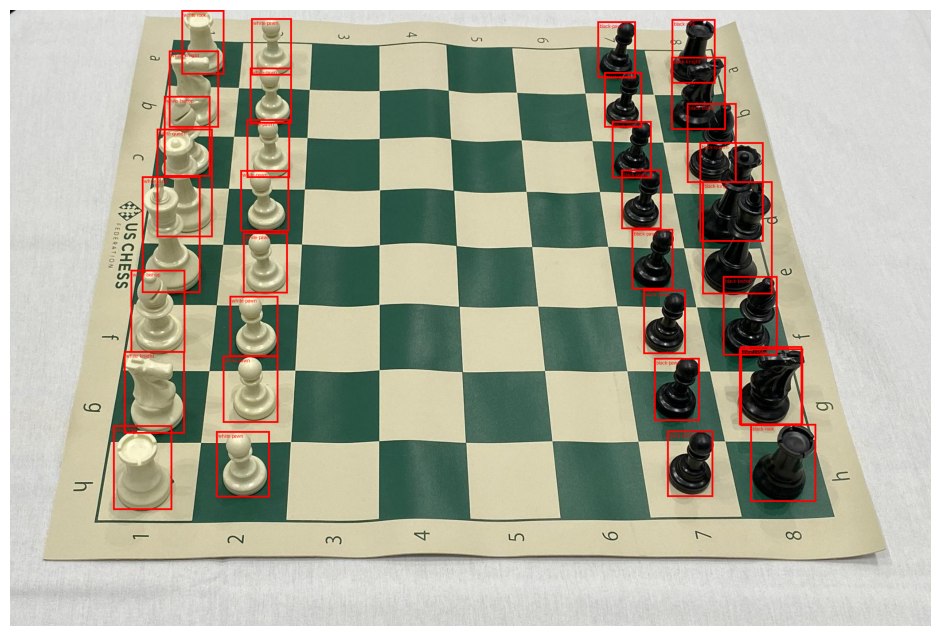

In [13]:
model.eval()

# Inferencja na zadanym obrazie
preprocess = (
    M.FasterRCNN_ResNet50_FPN_Weights.COCO_V1.transforms()
)  # to wystarczy pobrać raz
img = read_image(
    os.path.join(
        DATASET_ROOT, "test/IMG_0159_JPG.rf.1cf4f243b5072d63e492711720df35f7.jpg"
    )
)
batch = [preprocess(img).to(DEVICE)]
prediction = model(batch)[0]
# Rysowanie predykcji - wygodny gotowiec
box = draw_bounding_boxes(
    img,
    boxes=prediction["boxes"],
    labels=[chess_train.coco.cats[i.item()]["name"] for i in prediction["labels"]],
    colors="red",
    width=4,
)
# to_pil_image(box.detach()).show()

# Save the image with bounding boxes
output_path = "prediction_with_boxes.jpg"
to_pil_image(box.detach()).save(output_path)

print(f"Image saved to {output_path}")
# Display the image with bounding boxes using matplotlib
plt.figure(figsize=(12, 8))
plt.imshow(box.permute(1, 2, 0))
plt.axis("off")
plt.show()

---

### Zadanie 1

Zbadaj wpływ parametrów inferencji **głowic `RoIHeads`**, progu prawdopodobieństwa (`score_thresh`) i progu NMS (`nms_thresh`), na działanie modelu. Wykorzystaj funkcję `evaluate` aby zmierzyć zmianę jakości predykcji, ale przebadaj też efekty wizualnie, wyświetlając predykcje dla kilku obrazów ze zbioru walidacyjnego i kilku spoza zbioru (folder `wild`). _W finalnej wersji pozostaw tylko wybrane interesujące przykłady._


- `score_thresh` - próg dla minimalnej wartości pewności predykcji, powyżej której model uznaje detekcję za wartą zachowania
  - niski próg (np. 0.01)
    - więcej detekcji
    - więcej false positive
    - mniej false negative
    - wysoki recall
    - niskie precision
  - wysoki próg (np. 0.1)
    - mniej detekcji
    - mniej false positive
    - więcej false negative
- `nms_thresh` - Non-Maximum Suppression (NMS) - określa próg jak bardzo mogą nakładać się bounding boxy (wg. wartości IoU)
  - Zawsze jedna detekcja o największym score jest zachowana
  - Dla każdej z detekcji, oblicza IoU z pozostałymi:
  - Usuwa detekcję, jeśli IoU > nms_thresh
  - Niskie wartości (np. 0.3) - usuwa więcej detekcji
  - Wysokie wartości (np. 0.7) - usuwa mniej detekcji


In [26]:
print(DEVICE)

cuda:0


#### Load model from checkpoint


In [28]:
print(f"Score threshold: {model.roi_heads.score_thresh}")
print(f"NMS threshold: {model.roi_heads.nms_thresh}")

Score threshold: 0.05
NMS threshold: 0.5


#### Get evaluation scores on validation dataset


In [30]:
def test_thresholds(
    model: FasterRCNN,
    nms_thresholds: list[float],
    score_thresholds: list[float],
    detections_per_img: int = 1000,
) -> pd.DataFrame:

    print(f"Constant {detections_per_img=}")
    model.roi_heads.detections_per_img = detections_per_img

    results = []
    for score_thresh in score_thresholds:
        print("-" * 50)
        print("-" * 50)
        print(f"{score_thresh=}")

        model.roi_heads.score_thresh = score_thresh
        for nms_thresh in nms_thresholds:
            print("-" * 50)
            print(f"{nms_thresh=}")

            model.roi_heads.nms_thresh = nms_thresh
            evaluation = evaluate(model, val_loader, device=DEVICE)
            result = {
                "nms_threshold": nms_thresh,
                "score_threshold": score_thresh,
                "evaluation": evaluation,
            }
            results.append(result)

    nms_results_df = pd.DataFrame(results)
    return nms_results_df

In [31]:
def extract_metrics(evaluation):
    coco_eval = evaluation.coco_eval["bbox"]
    if coco_eval is not None:
        return {
            "AP_50_95": coco_eval.stats[0],  # AP @ IoU=0.50:0.95
            "AP_50": coco_eval.stats[1],  # AP @ IoU=0.50
            "AP_75": coco_eval.stats[2],  # AP @ IoU=0.75
            "AR_50_95_1": coco_eval.stats[6],  # AR @ IoU=0.50:0.95, maxDets=1
            "AR_50_95_10": coco_eval.stats[7],  # AR @ IoU=0.50:0.95, maxDets=10
            "AR_50_95_100": coco_eval.stats[8],  # AR @ IoU=0.50:0.95, maxDets=100
        }
    return {
        "AP_50_95": None,
        "AP_50": None,
        "AP_75": None,
        "AR_50_95_1": None,
        "AR_50_95_10": None,
        "AR_50_95_100": None,
    }

In [32]:
def print_coco_metrics(results_df, key="score_threshold", key_label="Score Threshold"):
    """
    Print COCO evaluation metrics from a DataFrame.

    Args:
        results_df (pd.DataFrame): DataFrame containing evaluation results.
            - Must include a column with the given `key` (e.g., `score_threshold`, `nms_threshold`).
            - Must include a column with `evaluation` objects (CocoEvaluator).
        key (str): Column name for the parameter to vary (e.g., `score_threshold` or `nms_threshold`).
        key_label (str): Label to display for the parameter in the output.

    Returns:
        None: Prints the metrics for each value of the parameter.
    """
    # Print metrics for each value of the key

    for _, row in results_df.iterrows():
        param_value = row[key]
        evaluation = row["evaluation"]
        metrics = extract_metrics(evaluation)

        if metrics:
            print(f"{key_label}: {param_value}")
            for metric, value in metrics.items():
                print(f"  {metric}: {value:.4f}")
            print("-" * 40)

In [33]:
def plot_coco_metrics(results_df, x_key="score_threshold", x_label="Score Threshold"):
    """
    Plot COCO evaluation metrics (Average Precision and Average Recall) from a DataFrame.

    Args:
        results_df (pd.DataFrame): DataFrame containing evaluation results.
            - `x_key`: A numerical column to use as the x-axis (e.g., `score_threshold`, `nms_threshold`).
            - `evaluation`: A column with CocoEvaluator objects containing metrics.
        x_key (str): The column name to use for the x-axis (e.g., `score_threshold`, `nms_threshold`).
        x_label (str): The label for the x-axis.

    Returns:
        None: Displays the bar charts for AP and AR metrics.
    """

    metrics_df = results_df["evaluation"].apply(extract_metrics).apply(pd.Series)
    results_df = pd.concat([results_df, metrics_df], axis=1)

    fig, axes = plt.subplots(2, 1, figsize=(14, 12))

    ap_columns = ["AP_50_95", "AP_50", "AP_75"]
    ap_values = results_df[ap_columns].T
    ap_values.columns = results_df[x_key].astype(str)

    ap_values.plot(
        kind="bar",
        ax=axes[0],
        legend=True,
        title="Average Precision (AP) Metrics",
        xlabel="Metrics",
        ylabel="Average Precision (AP)",
    )
    axes[0].legend(title=x_label)
    axes[0].grid(axis="y", linestyle="--", alpha=0.7)

    ar_columns = ["AR_50_95_1", "AR_50_95_10", "AR_50_95_100"]
    ar_values = results_df[ar_columns].T
    ar_values.columns = results_df[x_key].astype(str)

    ar_values.plot(
        kind="bar",
        ax=axes[1],
        legend=True,
        title="Average Recall (AR) Metrics",
        xlabel="Metrics",
        ylabel="Average Recall (AR)",
    )
    axes[1].legend(title=x_label)
    axes[1].grid(axis="y", linestyle="--", alpha=0.7)

    plt.tight_layout()
    plt.show()

##### Get evaluation metrics for different score thresholds


In [34]:
print("Testing Score Thresholds:")
score_results_df = test_thresholds(
    model=model,
    score_thresholds=[0.0, 0.001, 0.01, 0.1, 1.0],
    nms_thresholds=[0.5],
    detections_per_img=1000,
)

print(score_results_df)

Testing Score Thresholds:
Constant detections_per_img=1000
--------------------------------------------------
--------------------------------------------------
score_thresh=0.0
--------------------------------------------------
nms_thresh=0.5
Test:  [ 0/58]  eta: 0:01:25  model_time: 0.6763 (0.6763)  evaluator_time: 0.0283 (0.0283)  time: 1.4757  data: 0.7586  max mem: 1522


KeyboardInterrupt: 

In [79]:
score_results_file = "score_thresh_results.pkl"
score_results_df.to_pickle(score_results_file)

In [80]:
score_results_df = pd.read_pickle(score_results_file)

In [24]:
display(score_results_df)

,score_threshold,evaluation
0,0.01,<detection.coco_eval.CocoEvaluator object at 0...
1,0.05,<detection.coco_eval.CocoEvaluator object at 0...
2,0.10,<detection.coco_eval.CocoEvaluator object at 0...
3,0.50,<detection.coco_eval.CocoEvaluator object at 0...


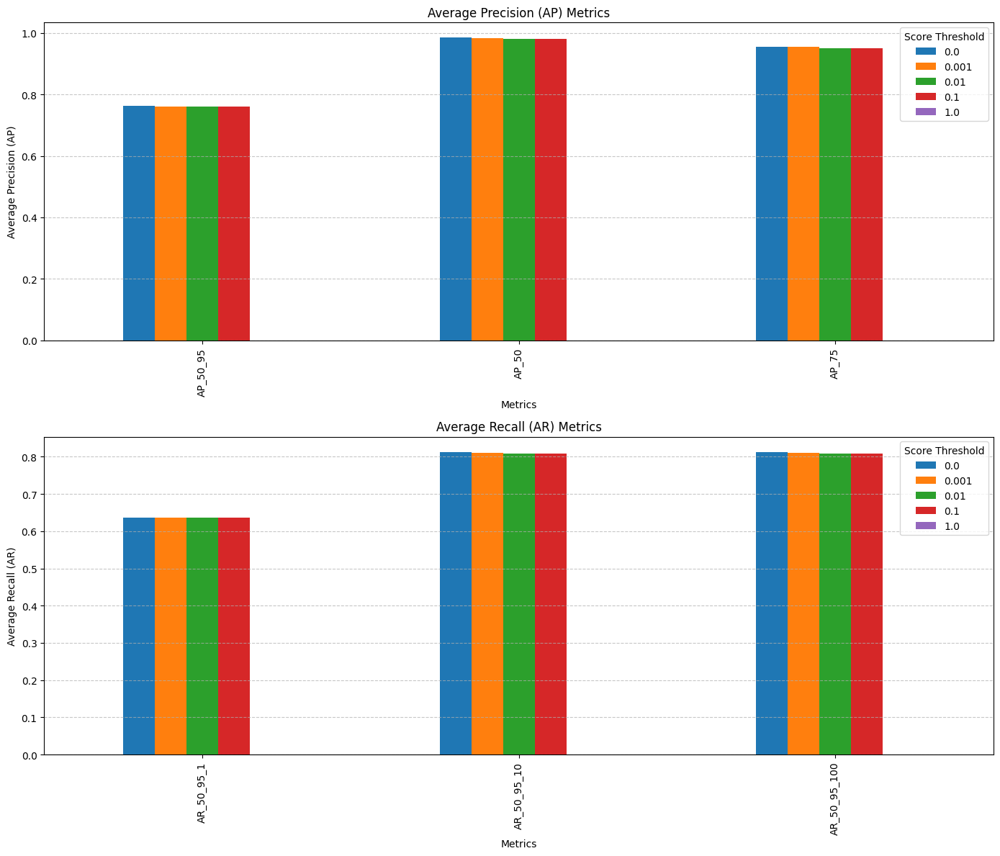

In [85]:
plot_coco_metrics(score_results_df, x_key="score_threshold", x_label="Score Threshold")

In [41]:
print_coco_metrics(score_results_df, key="score_threshold", key_label="Score Threshold")

Score Threshold: 0.01
  AP_50_95: 0.7592
  AP_50: 0.9799
  AP_75: 0.9504
  AR_50_95_1: 0.6374
  AR_50_95_10: 0.8081
  AR_50_95_100: 0.8081
----------------------------------------
Score Threshold: 0.05
  AP_50_95: 0.7592
  AP_50: 0.9799
  AP_75: 0.9504
  AR_50_95_1: 0.6374
  AR_50_95_10: 0.8081
  AR_50_95_100: 0.8081
----------------------------------------
Score Threshold: 0.1
  AP_50_95: 0.7592
  AP_50: 0.9799
  AP_75: 0.9504
  AR_50_95_1: 0.6374
  AR_50_95_10: 0.8081
  AR_50_95_100: 0.8081
----------------------------------------
Score Threshold: 0.5
  AP_50_95: 0.7592
  AP_50: 0.9799
  AP_75: 0.9504
  AR_50_95_1: 0.6374
  AR_50_95_10: 0.8081
  AR_50_95_100: 0.8081
----------------------------------------


##### Get evaluation metrics for different nms thresholds


In [83]:
print("\nTesting NMS Thresholds:")

nms_thresholds = [0.3, 0.5, 0.7]
detections_per_img = 1000

nms_results_df = test_thresholds(
    model=model,
    nms_thresholds=[0.3, 0.5, 0.7],
    score_thresholds=[0.05],
    detections_per_img=detections_per_img,
)
print(nms_results_df)


Testing NMS Thresholds:
Constant detections_per_img=1000
--------------------------------------------------
--------------------------------------------------
score_thresh=0.05
--------------------------------------------------
nms_thresh=0.3
Test:  [ 0/58]  eta: 0:01:27  model_time: 0.6452 (0.6452)  evaluator_time: 0.0050 (0.0050)  time: 1.5028  data: 0.8266  max mem: 1360
Test:  [57/58]  eta: 0:00:00  model_time: 0.6338 (0.6338)  evaluator_time: 0.0009 (0.0020)  time: 0.6514  data: 0.0078  max mem: 1360
Test: Total time: 0:00:38 (0.6675 s / it)
Averaged stats: model_time: 0.6338 (0.6338)  evaluator_time: 0.0009 (0.0020)
Accumulating evaluation results...
DONE (t=0.05s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.759
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.980
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.950
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | max

In [30]:
nms_thresh_results_file = "nms_thresh_results.pkl"
nms_results_df.to_pickle(nms_thresh_results_file)

In [31]:
nms_results_df = pd.read_pickle(nms_thresh_results_file)

In [32]:
display(nms_results_df)

,nms_threshold,evaluation
0,0.3,<detection.coco_eval.CocoEvaluator object at 0...
1,0.5,<detection.coco_eval.CocoEvaluator object at 0...
2,0.7,<detection.coco_eval.CocoEvaluator object at 0...


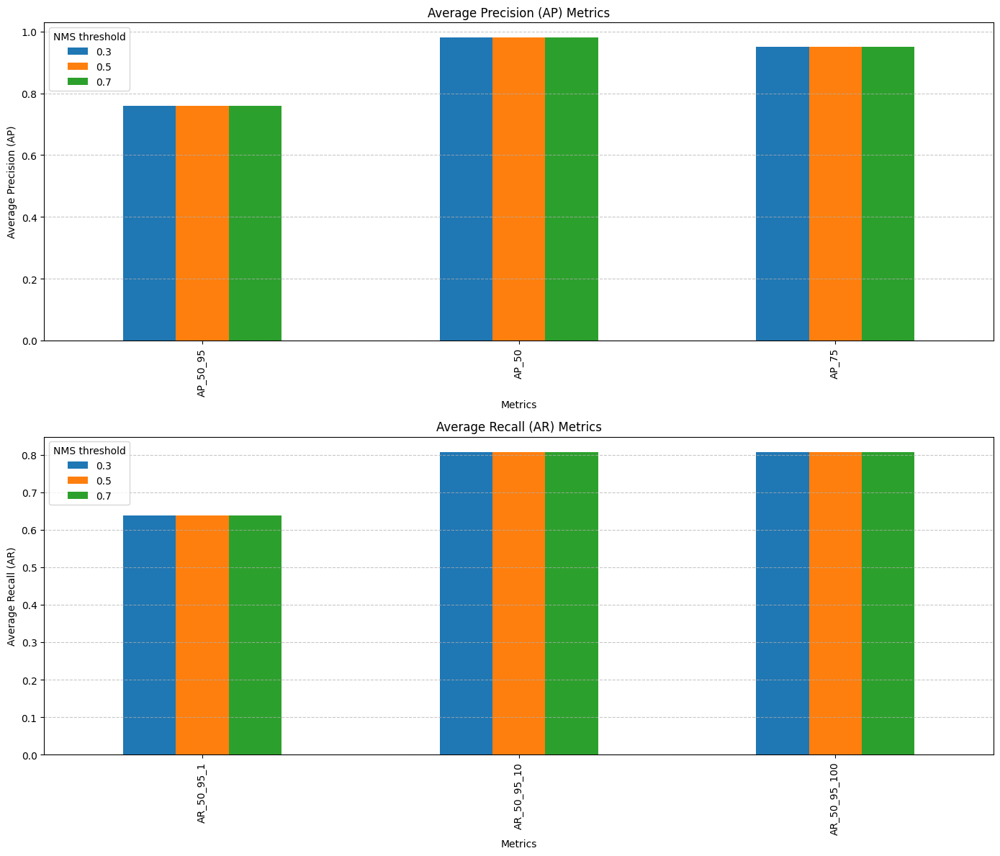

In [84]:
plot_coco_metrics(nms_results_df, x_key="nms_threshold", x_label="NMS threshold")

#### Visualize bbox predictions


In [34]:
import PIL
import os
import matplotlib.pyplot as plt

In [35]:
def visualize_predictions(model, image_path, title="") -> tuple[PIL.Image.Image, int]:
    """
    Visualize predictions and return the number of results.

    Args:
        model: The object detection model.
        image_path (str): Path to the input image.
        title (str): Title for visualization (optional).

    Returns:
        tuple: A tuple containing:
            - PIL.Image.Image: The image with bounding boxes drawn.
            - int: The number of predictions (results).
    """
    img = read_image(image_path)
    preprocess = M.FasterRCNN_ResNet50_FPN_Weights.COCO_V1.transforms()
    batch = [preprocess(img).to(DEVICE)]

    with torch.no_grad():
        prediction = model(batch)[0]

    num_results = len(prediction["boxes"])

    box = draw_bounding_boxes(
        img,
        boxes=prediction["boxes"],
        labels=[chess_train.coco.cats[i.item()]["name"] for i in prediction["labels"]],
        colors="red",
        width=4,
    )
    return to_pil_image(box.detach()), num_results

##### Visualize for different score threshold


/home/piotr/projects/ai/apow/venv/lib/python3.12/site-packages/torchvision/utils.py:211: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


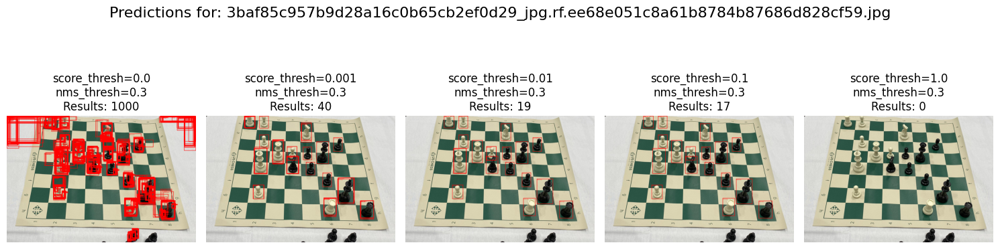

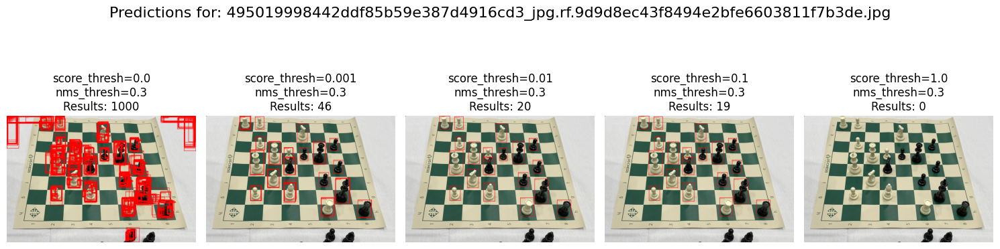

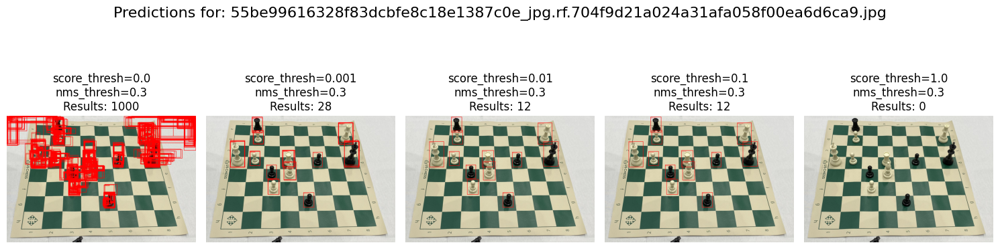

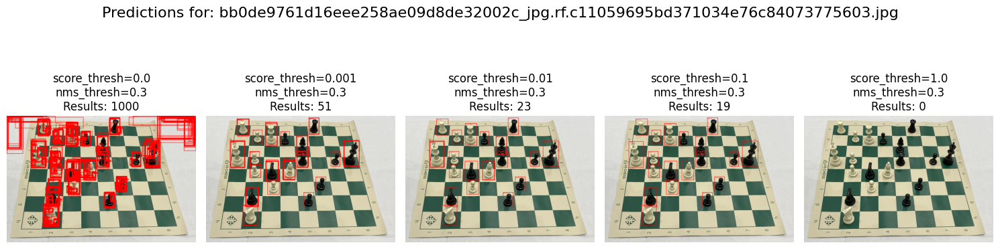

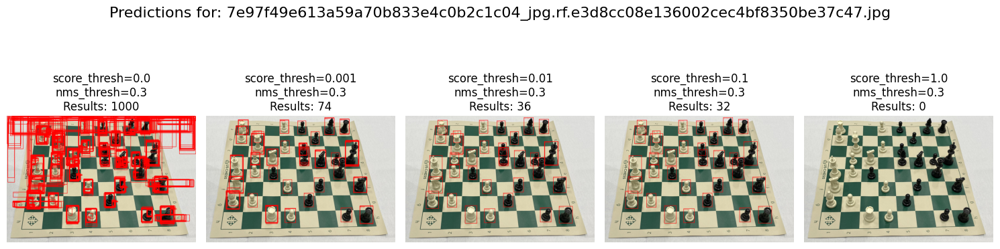

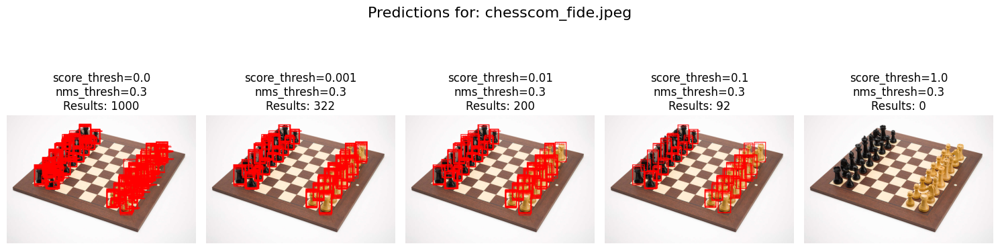

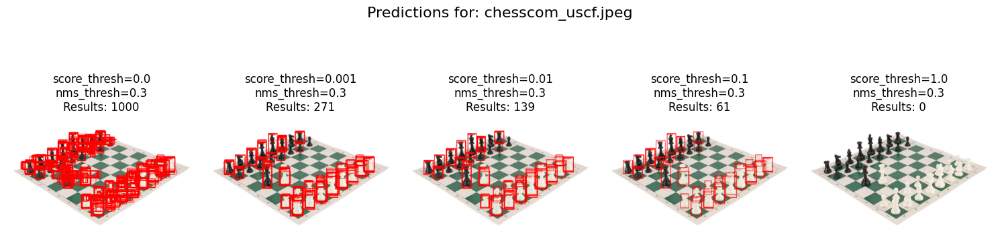

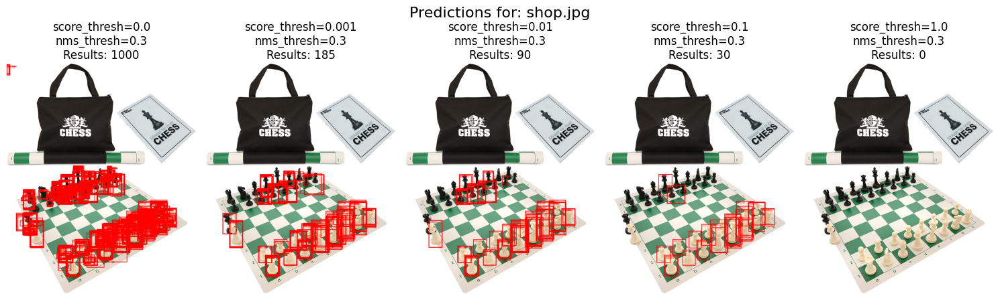

In [88]:
score_thresholds = [0.0, 0.001, 0.01, 0.1, 1.0]

nms_thresh = 0.3
model.roi_heads.nms_thresh = nms_thresh
model.roi_heads.detections_per_img = 1000

for image in file_names:
    fig, axes = plt.subplots(1, len(score_thresholds), figsize=(15, 5))
    image_path = os.path.join(DATASET_ROOT, image)

    for i, score_thresh in enumerate(score_thresholds):
        model.roi_heads.score_thresh = score_thresh

        pred_img, num_results = visualize_predictions(
            model, image_path, f"Score threshold: {score_thresh}"
        )

        axes[i].imshow(pred_img)
        axes[i].set_title(f"{score_thresh=}\n{nms_thresh=}\nResults: {num_results}")
        axes[i].axis("off")

    fig.suptitle(f"Predictions for: {os.path.basename(image)}", fontsize=16)
    plt.tight_layout()
    plt.show()

In [1]:
score_thresholds = [0.1, 0.5, 0.9, 1.0]

nms_thresh = 0.3
model.roi_heads.nms_thresh = nms_thresh
model.roi_heads.detections_per_img = 1000

for image in file_names:
    fig, axes = plt.subplots(1, len(score_thresholds), figsize=(15, 5))
    image_path = os.path.join(DATASET_ROOT, image)

    for i, score_thresh in enumerate(score_thresholds):
        model.roi_heads.score_thresh = score_thresh

        pred_img, num_results = visualize_predictions(
            model, image_path, f"Score threshold: {score_thresh}"
        )

        axes[i].imshow(pred_img)
        axes[i].set_title(f"{score_thresh=}\n{nms_thresh=}\nResults: {num_results}")
        axes[i].axis("off")

    fig.suptitle(f"Predictions for: {os.path.basename(image)}", fontsize=16)
    plt.tight_layout()
    plt.show()

SyntaxError: invalid syntax. Perhaps you forgot a comma? (2509825165.py, line 1)

##### Visualize fo different NMS threshold


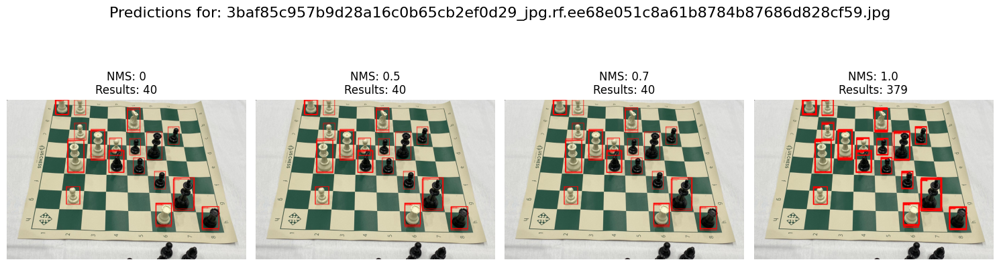

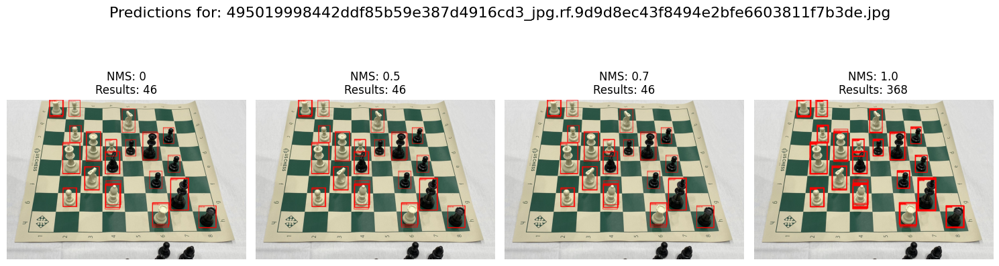

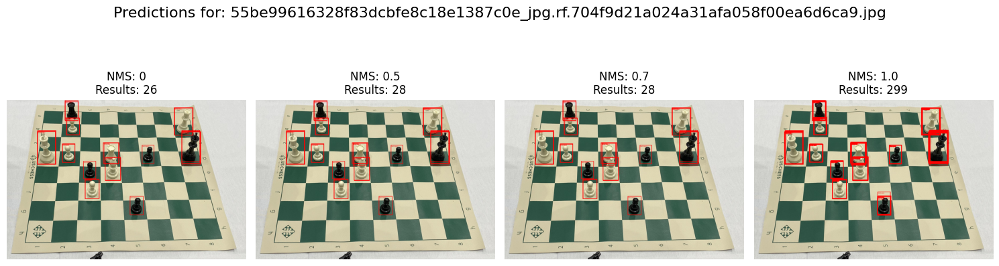

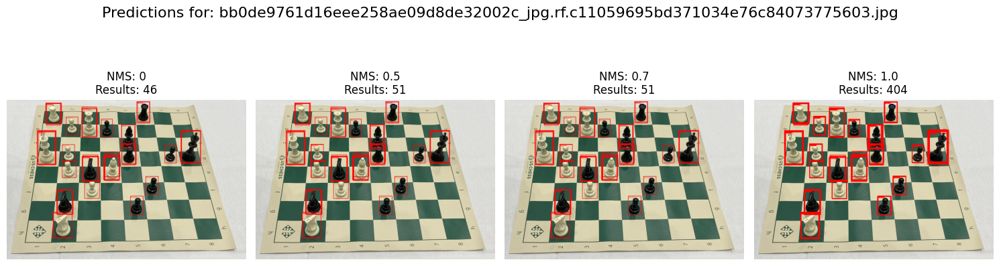

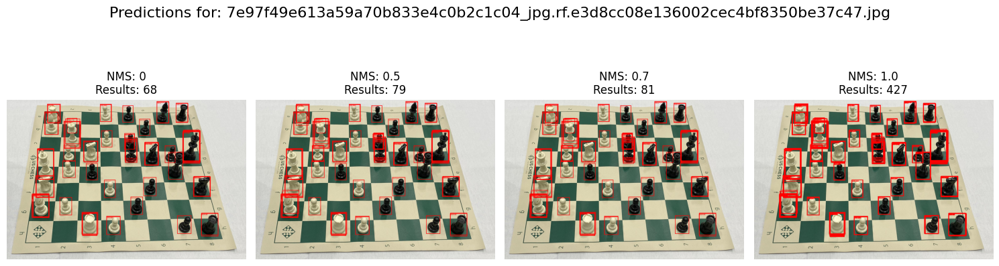

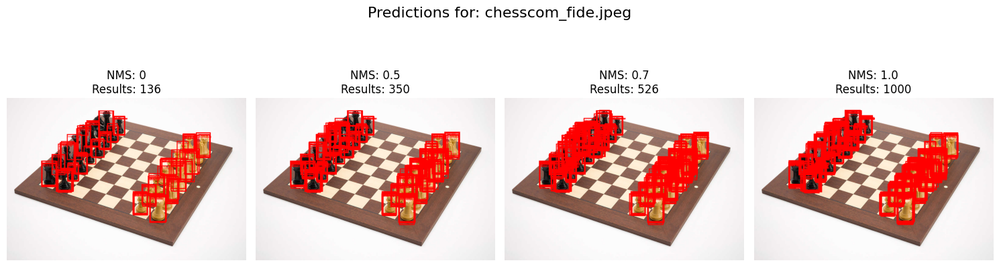

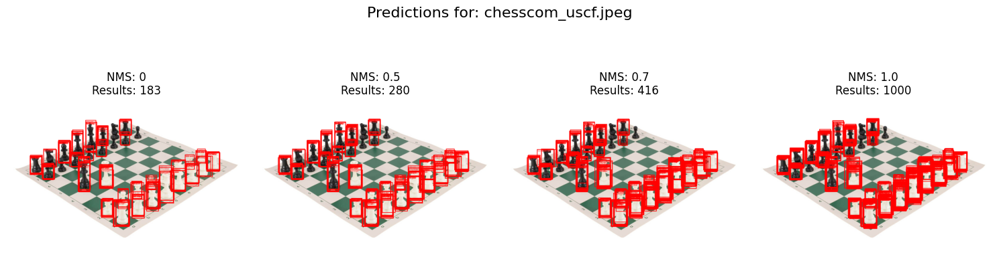

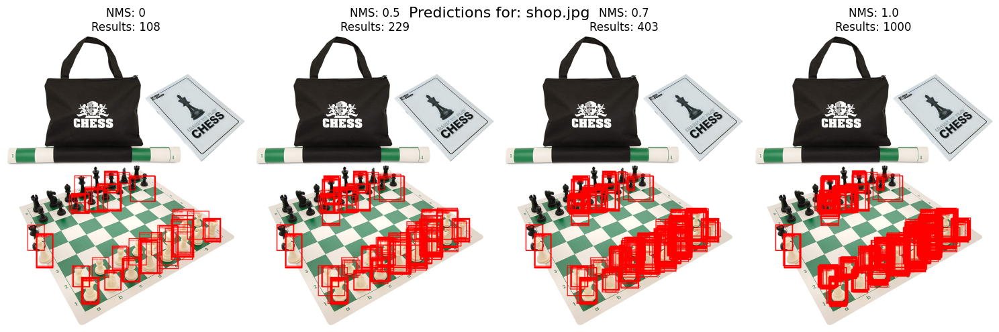

In [91]:
nms_thresholds = [0, 0.5, 0.7, 1.0]
model.roi_heads.score_thresh = 0.001
model.roi_heads.detections_per_img = 1000

for image in file_names:
    fig, axes = plt.subplots(1, len(nms_thresholds), figsize=(15, 5))
    image_path = os.path.join(DATASET_ROOT, image)

    for i, nms_thresh in enumerate(nms_thresholds):
        model.roi_heads.nms_thresh = nms_thresh

        pred_img, num_results = visualize_predictions(
            model, image_path, f"NMS threshold: {nms_thresh}"
        )

        axes[i].imshow(pred_img)
        axes[i].set_title(f"NMS: {nms_thresh}\nResults: {num_results}")
        axes[i].axis("off")

    fig.suptitle(f"Predictions for: {os.path.basename(image)}", fontsize=16)
    plt.tight_layout()
    plt.show()

- Podwyższenie progu: Większa tolerancja dla nakładających się obszarów. Może skutkować większą liczbą wykrytych duplikatów (np. wiele ramek obejmujących ten sam obiekt).
- Obniżenie progu: Bardziej rygorystyczne filtrowanie, co zwiększa precyzję (mniejsza liczba duplikatów). Istnieje jednak ryzyko odrzucenia prawidłowych wykryć obiektów tej samej klasy nakłądających się częściowo (np. za sobą)


### Zadanie 2a

Zwizualizuj propozycje rejonów wygenerowane przez RPN i porównaj z ostateczną predykcją.

W tym celu konieczne będzie manualne wykonanie fragmentu metody `GeneralizedRCNN::forward` (patrz: [kod](https://github.com/pytorch/vision/blob/6279faa88a3fe7de49bf58284d31e3941b768522/torchvision/models/detection/generalized_rcnn.py#L46), link do wersji najnowszej na grudzień 2024).
Wszystkie fragmenty związane z uczeniem możesz rzecz jasna pominąć; chodzi o wyciągnięcie obiektu `proposals`.
Nie zapomnij o wykonaniu powrotnej transformacji! (Po co?)


In [14]:
from typing import OrderedDict

In [21]:
from torchvision.models.detection.transform import resize_boxes

In [43]:
def get_proposals_and_detections(
    model: FasterRCNN,
    images: list[torch.Tensor],
    targets=None,
) -> tuple[list[torch.Tensor], list[dict[str, torch.Tensor]]]:

    model.eval()

    original_image_sizes: list[tuple[int, int]] = []
    for img in images:
        val = img.shape[-2:]
        torch._assert(
            len(val) == 2,
            f"expecting the last two dimensions of the Tensor to be H and W instead got {img.shape[-2:]}",
        )
        original_image_sizes.append((val[0], val[1]))

    images, targets = model.transform(images, targets)

    features = model.backbone(images.tensors)
    if isinstance(features, torch.Tensor):
        features = OrderedDict([("0", features)])
    proposals, proposal_losses = model.rpn(images, features, targets)
    detections, detector_losses = model.roi_heads(
        features, proposals, images.image_sizes, targets
    )
    detections = model.transform.postprocess(
        detections, images.image_sizes, original_image_sizes
    )

    # resize the proposals
    proposals = [
        resize_boxes(proposal, original_size, list(new_size))
        for proposal, original_size, new_size in zip(
            proposals, images.image_sizes, original_image_sizes
        )
    ]

    return proposals, detections


def draw_proposals_and_detections(
    image: torch.Tensor,
    proposals: torch.Tensor,
    detections: dict[str, torch.Tensor],
) -> torch.Tensor:
    proposal_img = draw_bounding_boxes(
        image.cpu(), boxes=proposals, colors="yellow", width=1
    )

    final_img = draw_bounding_boxes(
        proposal_img, boxes=detections["boxes"], colors="red", width=2
    )
    return final_img

In [57]:
file_paths = [os.path.join(DATASET_ROOT, img_path) for img_path in file_names]

#### Visualize proposals and detections


Number of proposals: 1000
Number of detections: 17


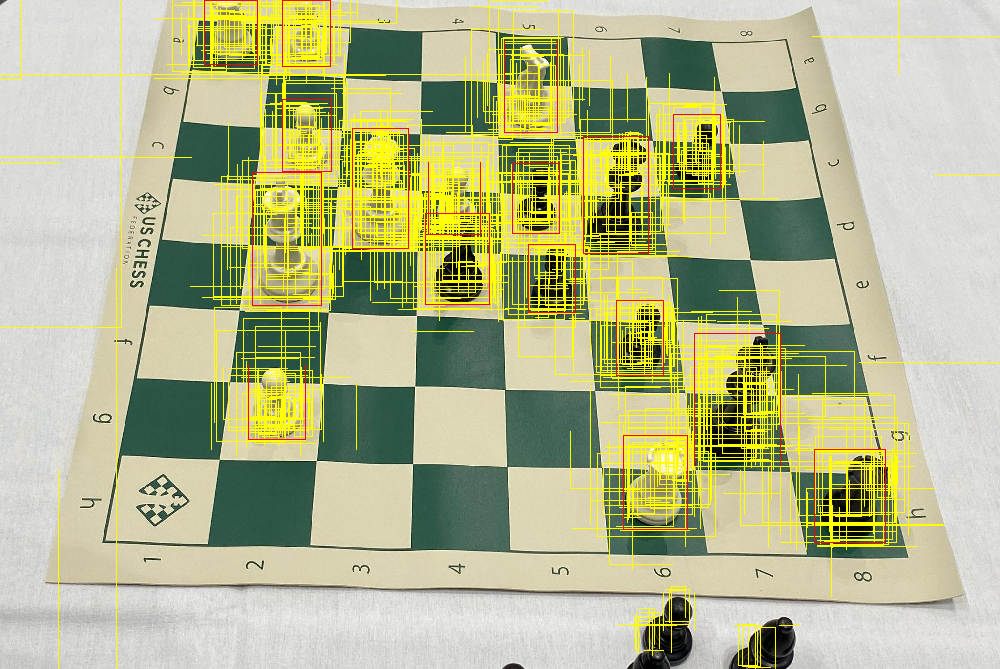

Number of proposals: 1000
Number of detections: 19


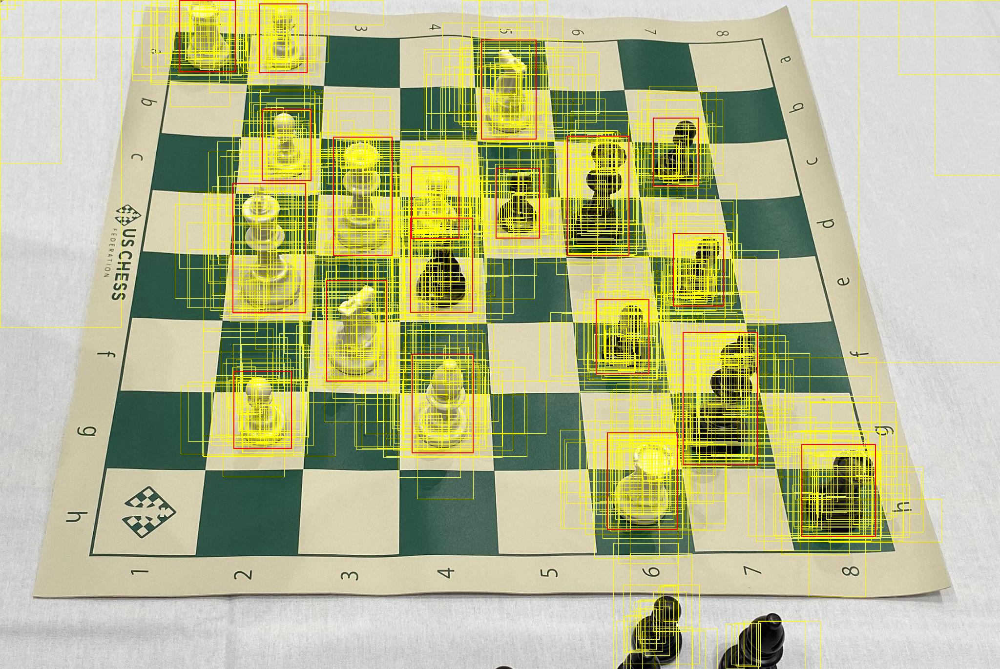

Number of proposals: 1000
Number of detections: 12


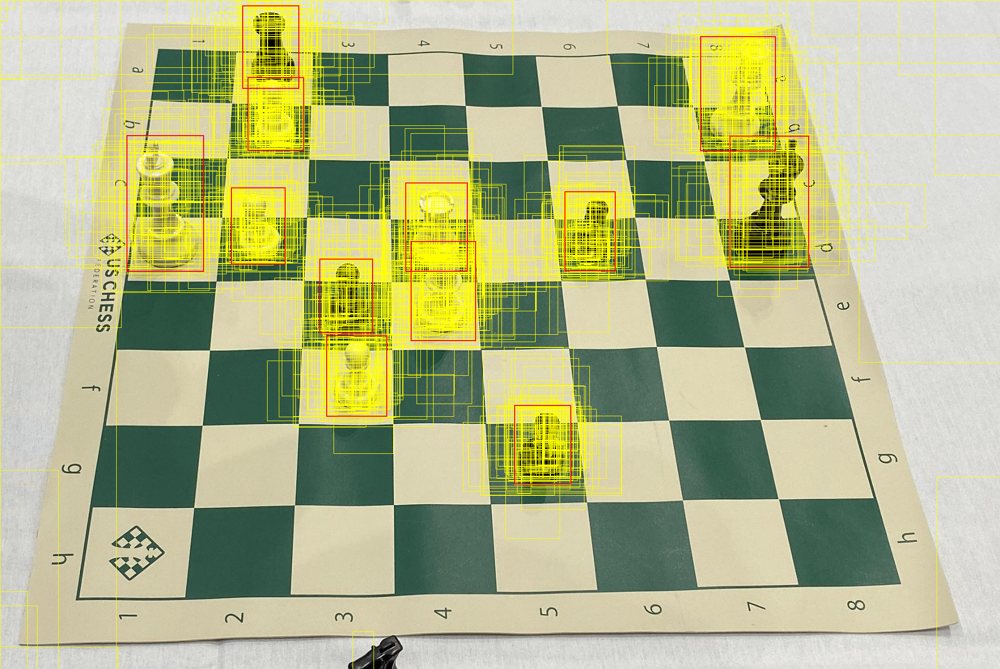

Number of proposals: 1000
Number of detections: 19


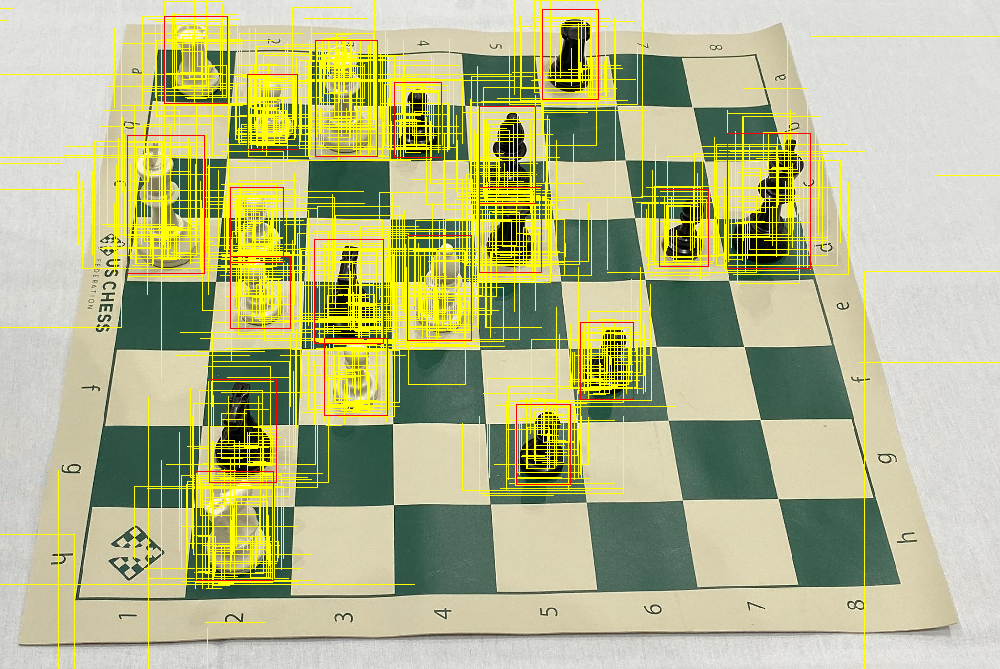

Number of proposals: 1000
Number of detections: 33


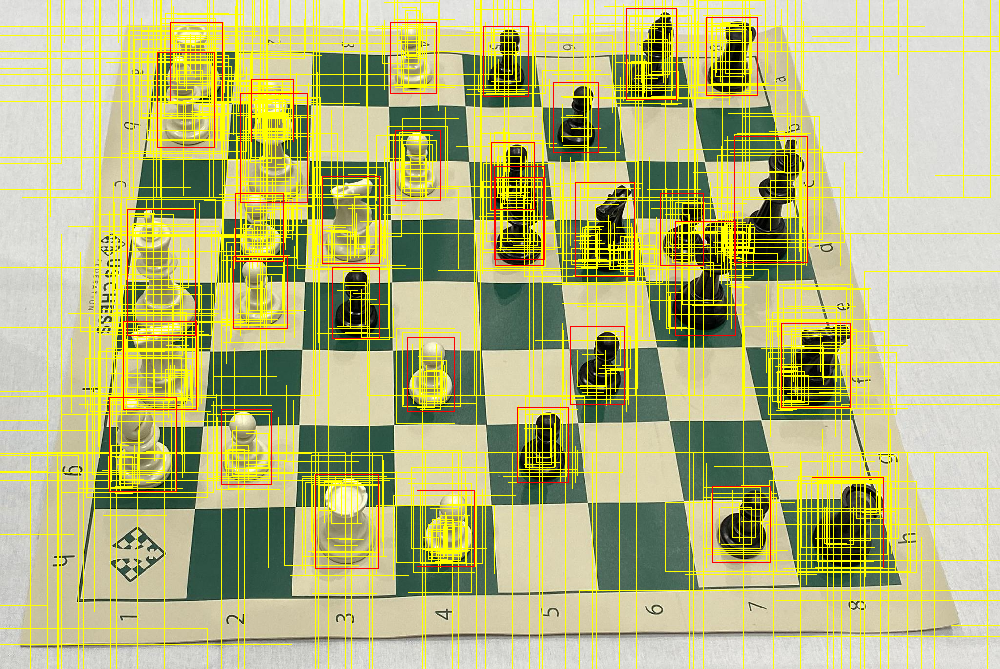

Number of proposals: 1000
Number of detections: 100


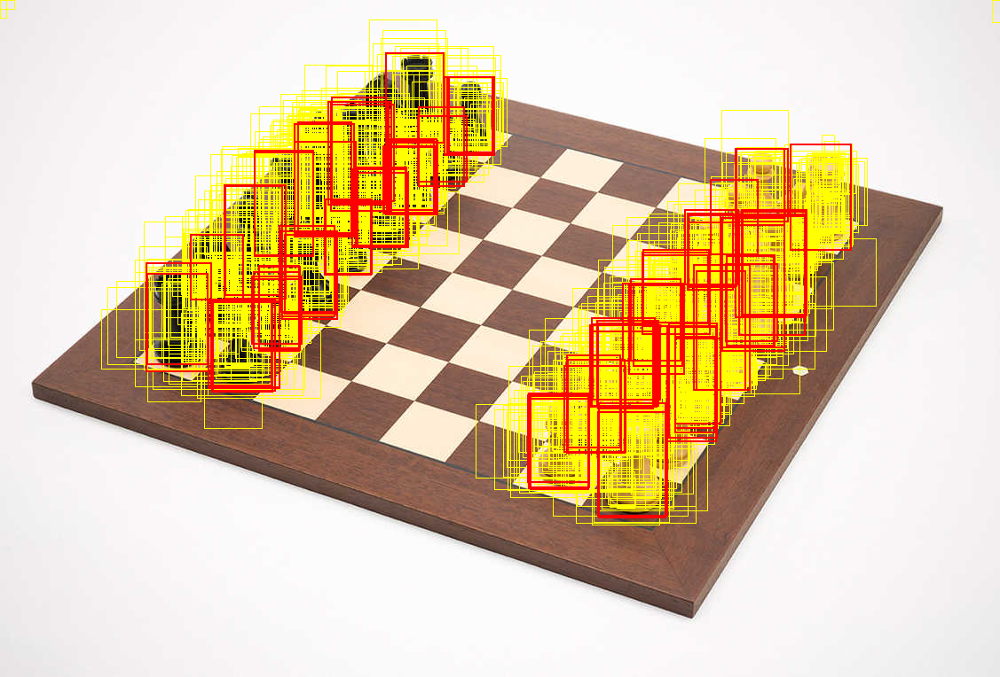

Number of proposals: 1000
Number of detections: 82


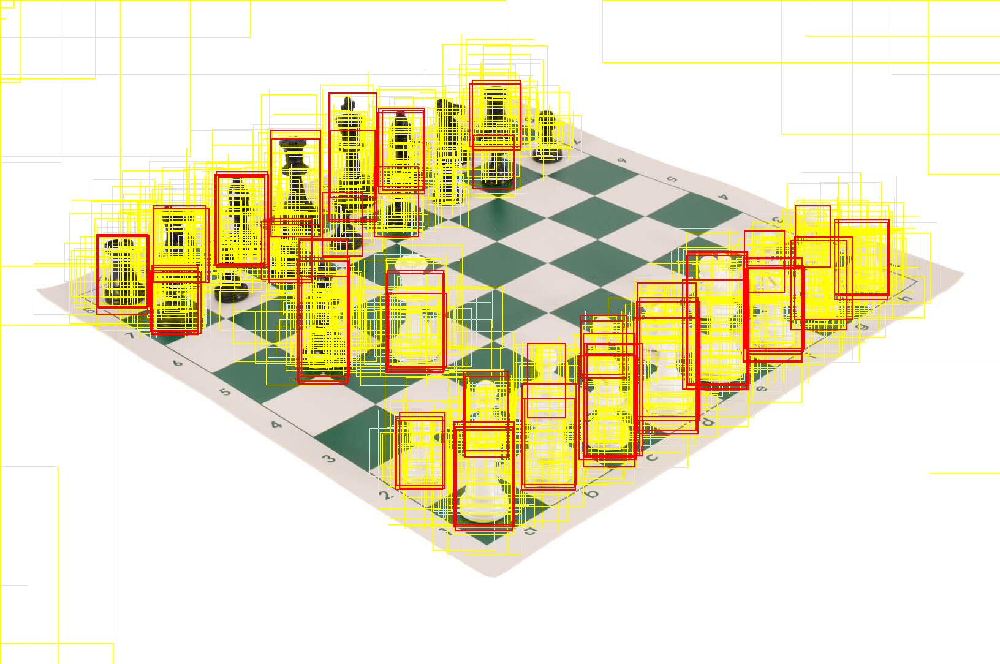

Number of proposals: 1000
Number of detections: 46


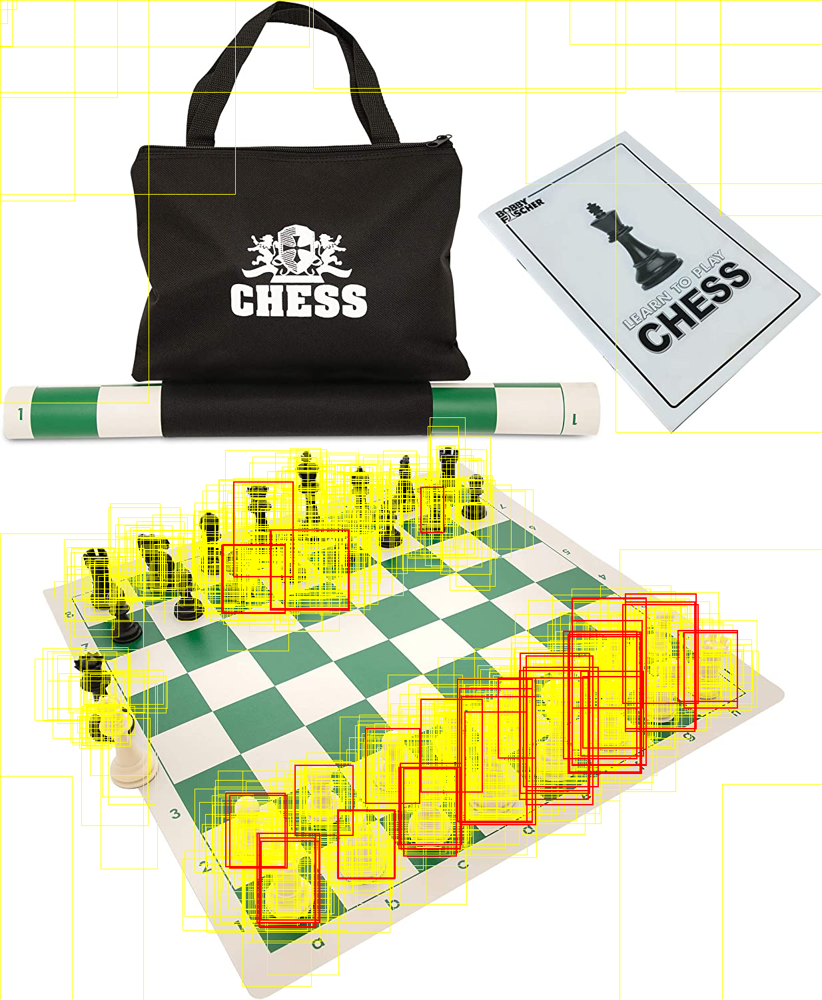

In [49]:
model.roi_heads.detections_per_img = 100

for image in file_paths:

    image = torchvision.io.read_image(image)
    image = preprocess(image).to(DEVICE)

    proposals, detections = get_proposals_and_detections(model, [image])
    proposals = proposals[0]
    detections = detections[0]

    final_img = draw_proposals_and_detections(image, proposals, detections)

    print(f"Number of proposals: {proposals.shape[0]}")
    print(f"Number of detections: {detections["boxes"].shape[0]}")
    display(to_pil_image(final_img))

### Zadanie 2b

Zbadaj wpływ progu NMS _na etapie propozycji_ na jakość predykcji oraz czas ich uzyskania.
Jak w poprzednich zadaniach, postaraj się nie ograniczyć tylko do pokazania metryk, ale pokaż wizualizacje (propozycji i predykcji) dla **wybranych** przykładów.


In [ ]:
model.roi_heads.detections_per_img = 100

for image in file_paths:

    image = torchvision.io.read_image(image)
    image = preprocess(image).to(DEVICE)
    batch = [image]

    proposals, detections = get_proposals_and_detections(model, batch)
    proposals = proposals[0]
    detections = detections[0]

    final_img = draw_proposals_and_detections(image, proposals, detections)

    print(f"Number of proposals: {proposals.shape[0]}")
    print(f"Number of detections: {detections["boxes"].shape[0]}")
    display(to_pil_image(final_img))

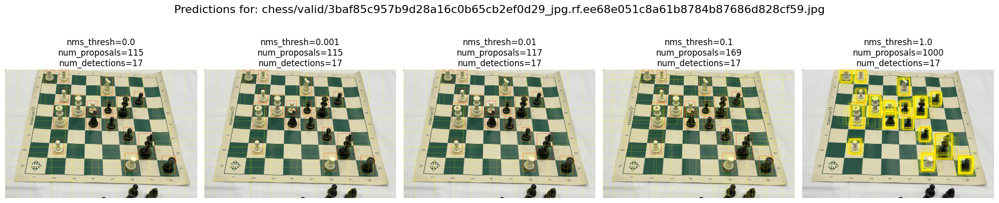

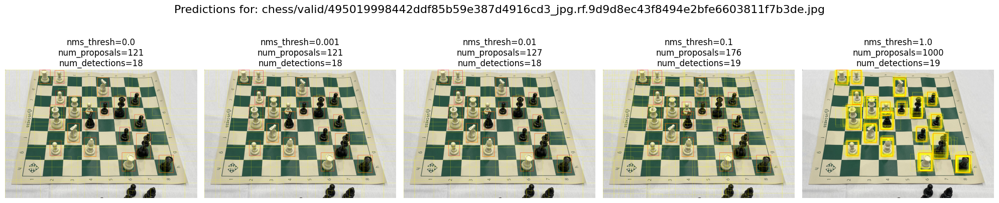

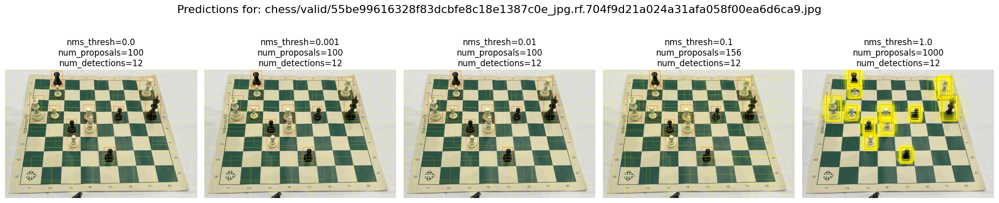

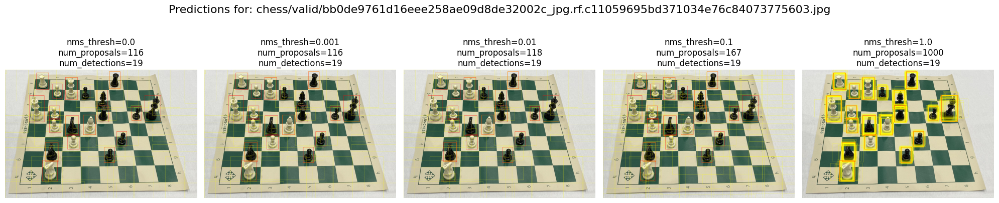

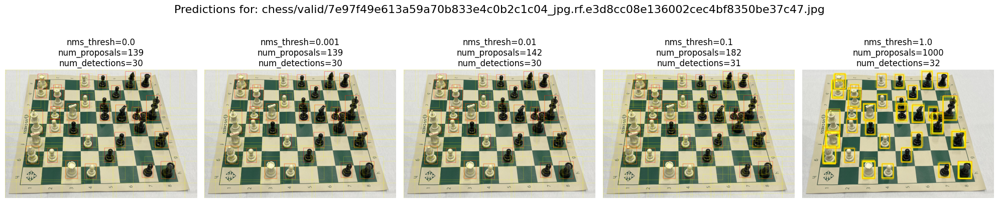

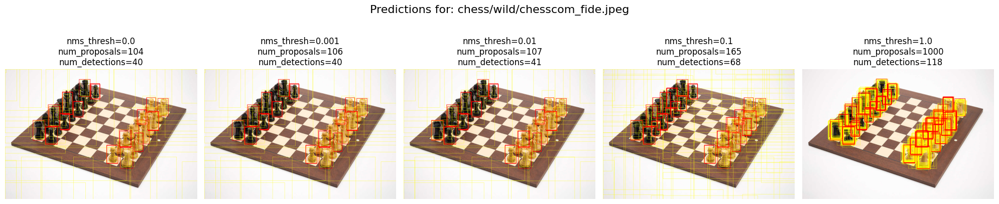

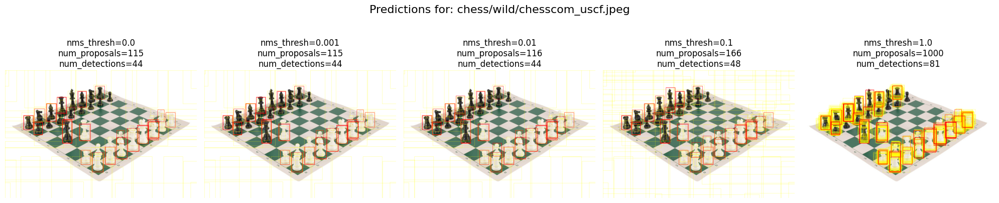

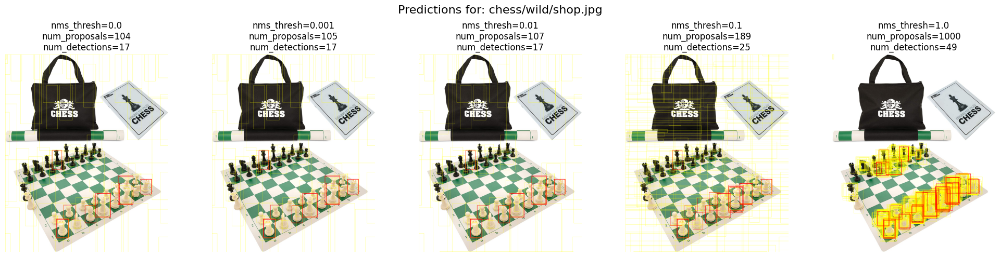

In [63]:
nms_thresholds = [0.0, 0.001, 0.01, 0.1, 1.0]

nms_thresh = 0.3
# model.roi_heads.nms_thresh = nms_thresh
model.roi_heads.detections_per_img = 1000

for image_path in file_paths:
    fig, axes = plt.subplots(1, len(nms_thresholds), figsize=(20, 5))
    image = torchvision.io.read_image(image_path)
    image = preprocess(image).to(DEVICE)
    batch = [image]

    for i, nms_thresh in enumerate(nms_thresholds):
        model.rpn.nms_thresh = nms_thresh

        proposals, detections = get_proposals_and_detections(model, batch)

        pred_image = draw_proposals_and_detections(image, proposals[0], detections[0])
        pred_image = to_pil_image(pred_image)
        num_proposals = proposals[0].shape[0]
        num_detections = detections[0]["boxes"].shape[0]

        axes[i].imshow(pred_image)
        axes[i].set_title(f"\n{nms_thresh=}\n{num_proposals=}\n{num_detections=}")
        axes[i].axis("off")

    fig.suptitle(f"Predictions for: {image_path}", fontsize=16)
    plt.tight_layout()
    plt.show()